In [1]:
import numpy as np
import pandas as pd
import os
from matplotlib import pyplot as plt
from glob import glob
import cv2
import pickle
from keras.utils import to_categorical
from PIL import ImageFile
from tqdm import tqdm
from keras.preprocessing import image 

from keras.utils import np_utils
import matplotlib.pyplot as plt
from keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D
from keras.layers import Dropout, Flatten, Dense
from keras.models import Sequential
from keras.optimizers import Adam
from keras.utils.vis_utils import plot_model
from keras.callbacks import ModelCheckpoint

from sklearn.model_selection import train_test_split

%matplotlib inline

# Data Collection

In [2]:
data_dir = '../input/state-farm-distracted-driver-detection/imgs'
test_dir = os.path.join(data_dir, 'test')
train_dir = os.path.join(data_dir,'train')
model_path = os.path.join(os.getcwd(),"model","self_trained")
pickle_dir = os.path.join(os.getcwd(),"pickle_files")
csv_dir = os.path.join(os.getcwd(),"csv_files")

In [3]:
if not os.path.exists(test_dir):
    print("Testing data does not exists")
if not os.path.exists(train_dir):
    print("Training data does not exists")
if not os.path.exists(model_path):
    print("Model path does not exists")
    os.makedirs(model_path)
    print("Model path created")
if not os.path.exists(pickle_dir):
    os.makedirs(pickle_dir)
if not os.path.exists(csv_dir):
    os.makedirs(csv_dir)

Model path does not exists
Model path created


In [5]:
df = pd.read_csv('../input/state-farm-distracted-driver-detection/driver_imgs_list.csv')
df.head()

,subject,classname,img
0,p002,c0,img_44733.jpg
1,p002,c0,img_72999.jpg
2,p002,c0,img_25094.jpg
3,p002,c0,img_69092.jpg
4,p002,c0,img_92629.jpg


The 10 classes to predict are:

* c0: safe driving
* c1: texting - right
* c2: talking on the phone - right
* c3: texting - left
* c4: talking on the phone - left
* c5: operating the radio
* c6: drinking
* c7: reaching behind
* c8: hair and makeup
* c9: talking to passenger

Text(0.5, 0, 'Class Name')

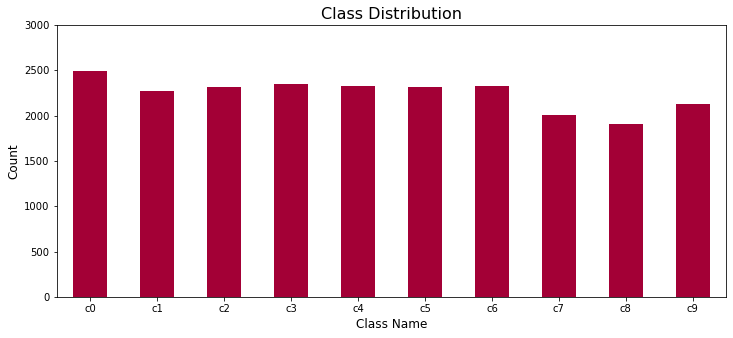

In [8]:
df2 = df.groupby('classname')['img'].count()

plt.figure(figsize=(12, 5))
df2.plot.bar(rot=0, color = '#a30036')
plt.title('Class Distribution', size = 16)
plt.ylim([0, 3000])
plt.ylabel('Count',size = 12)
plt.xlabel('Class Name',size = 12)

c0: safe driving


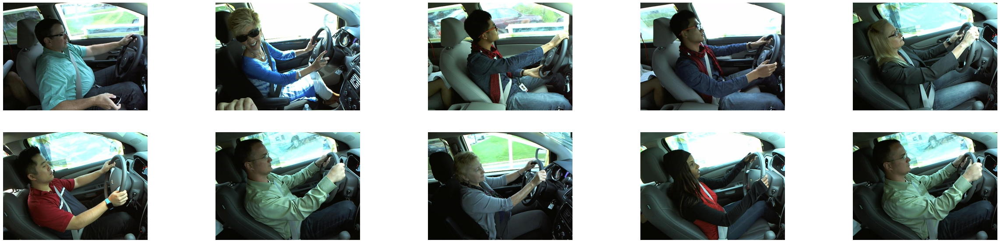

c1: texting - right


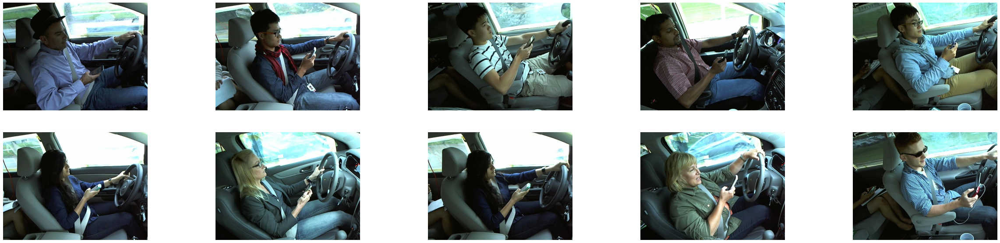

c2: talking on the phone - right


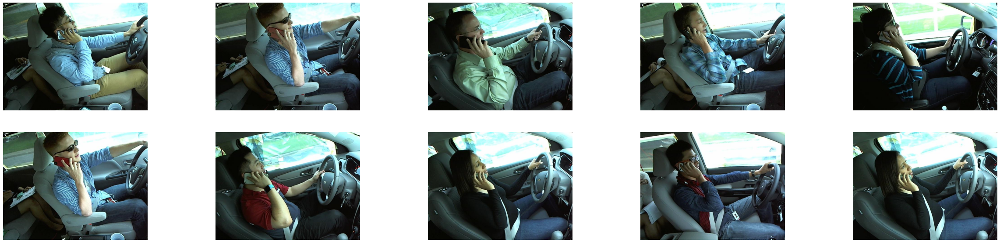

c3: texting - left


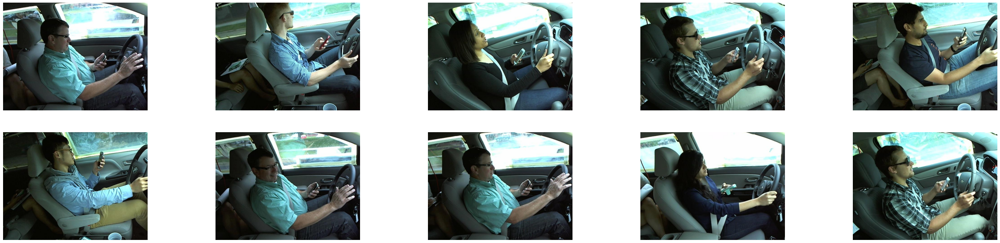

c4: talking on the phone - left


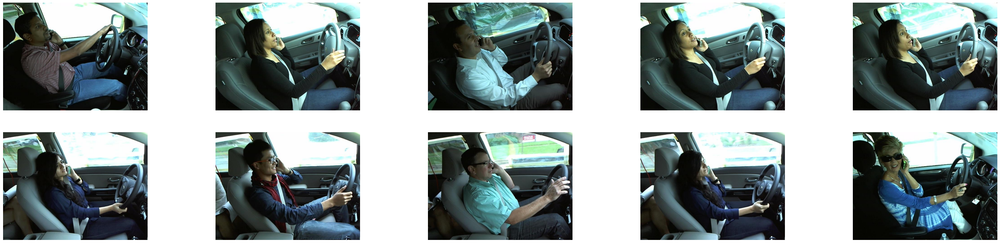

c5: operating the radio


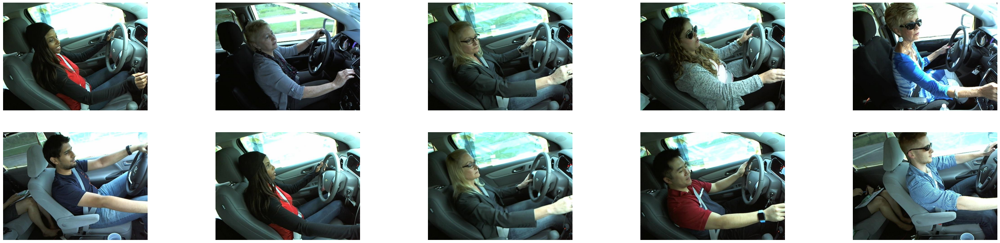

c6: drinking


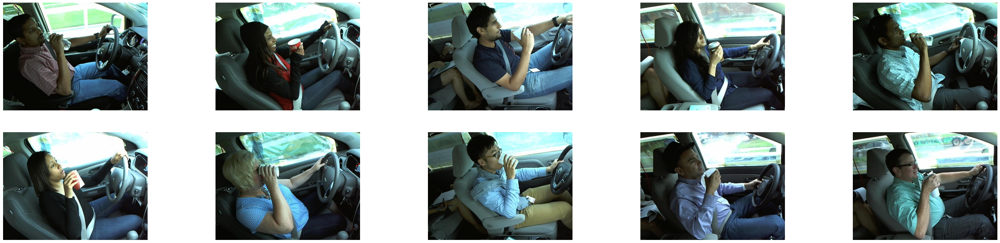

c7: reaching behind


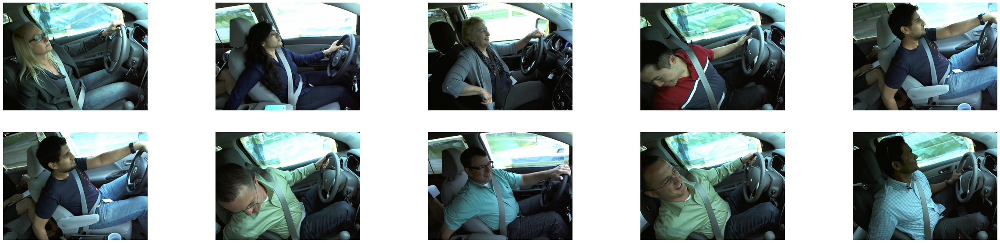

c8: hair and makeup


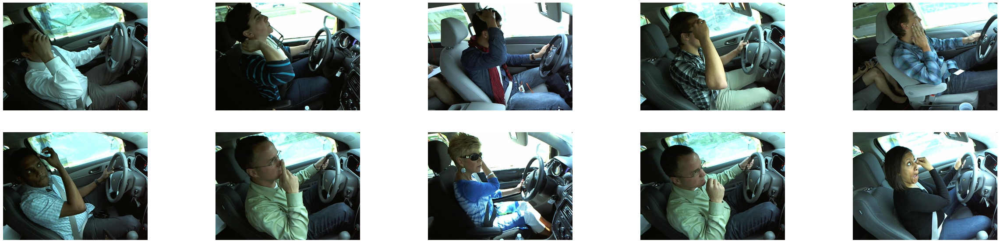

c9: talking to passenger


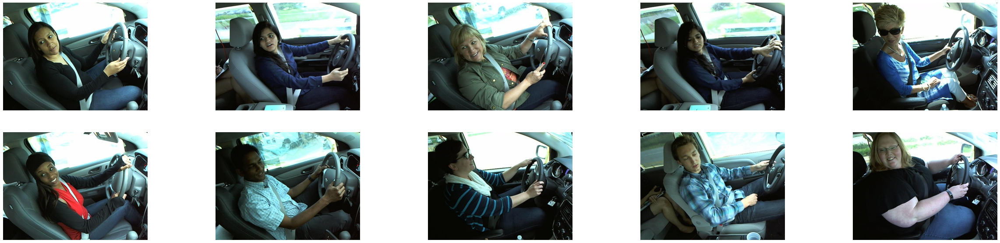

In [9]:
def read_image(path):
    image = cv2.imread(path, cv2.IMREAD_COLOR)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

labels = ['c0', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9']
classes = {
    'c0': 'safe driving',
    'c1': 'texting - right',
    'c2': 'talking on the phone - right',
    'c3': 'texting - left',
    'c4': 'talking on the phone - left',
    'c5': 'operating the radio',
    'c6': 'drinking',
    'c7': 'reaching behind',
    'c8': 'hair and makeup',
    'c9': 'talking to passenger',
}
for label in labels: 
    f, ax = plt.subplots(figsize=(42, 10))
    files = glob('{}/{}/*.jpg'.format(train_dir, label))
    
    print(label + ': ' + classes[label])
    for x in range(10):
        plt.subplot(2, 5, x+1)
        img = cv2.imread(files[x], cv2.IMREAD_COLOR)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.imshow(img)
        plt.axis('off')
    plt.show()

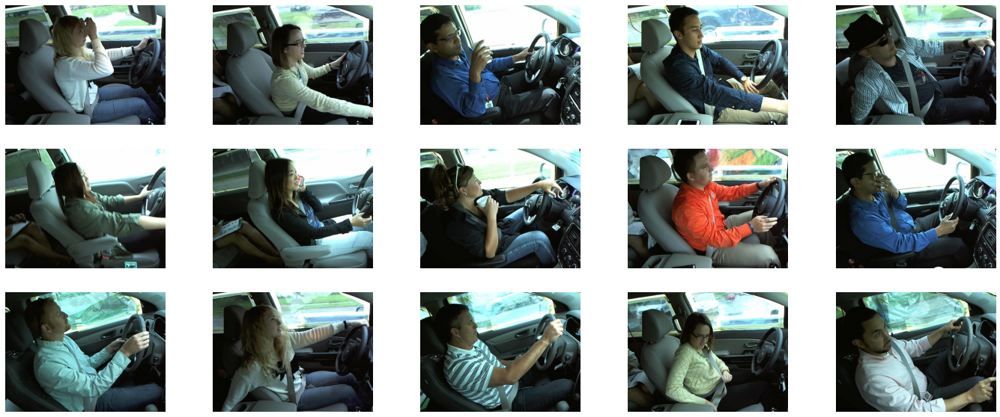

In [10]:
fig, ax = plt.subplots(figsize=(24, 10))
files = glob('{}/*.jpg'.format(test_dir))

for x in range(15):
    plt.subplot(3, 5, x+1)
    img = cv2.imread(files[x], cv2.IMREAD_COLOR)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.axis('off')
    
plt.show()

# Data Preparation

In [11]:
class_names = ['c0', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9']
data = []

for cn in class_names:
    files = os.listdir(os.path.join(train_dir, cn))
    for file in files: 
        data.append({
            'Filename': os.path.join(train_dir, cn, file),
            'Class': cn
        })
        
data = pd.DataFrame(data)
data.to_csv(os.path.join(os.getcwd(), 'csv_files', 'train.csv'),index=False)
train_data = pd.read_csv(os.path.join(os.getcwd(), 'csv_files', 'train.csv'))

In [12]:
data = []
cn = 'test'
files = os.listdir(test_dir)

for file in files:
    data.append(({
        'Filename': os.path.join(test_dir, file),
        'Class': cn
    }))

data = pd.DataFrame(data)
data.to_csv(os.path.join(os.getcwd(), 'csv_files', 'test.csv'),index=False)
test_data = pd.read_csv(os.path.join(os.getcwd(), 'csv_files', 'test.csv'))

In [13]:
list_labels = ['c0', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9']
labels_define = {label:x for x,label in enumerate(list_labels)}
print(labels_define)
train_data['Class'].replace(labels_define, inplace=True)

{'c0': 0, 'c1': 1, 'c2': 2, 'c3': 3, 'c4': 4, 'c5': 5, 'c6': 6, 'c7': 7, 'c8': 8, 'c9': 9}


In [14]:
with open(os.path.join(os.getcwd(),"pickle_files","labels_list.pkl"),"wb") as handle:
    pickle.dump(labels_define, handle)

In [15]:
labels = to_categorical(train_data['Class'])
print('---------------------------------------------------------')
print('Number of Labelled Samples:', labels.shape[0])
print('---------------------------------------------------------')

---------------------------------------------------------
Number of Labelled Samples: 22424
---------------------------------------------------------


In [16]:
x_train, x_test, y_train, y_test = train_test_split(train_data.iloc[:,0], labels, test_size = 0.4, random_state=42)

In [17]:
x_validation, x_test, y_validation, y_test = train_test_split(x_test, y_test, test_size = 0.5, random_state=42)

In [21]:
print('---------------------------------------------------------')
print('Number of Testing Samples:', len(x_train), '(', round(len(x_train)/22424, 2), ')')
print('---------------------------------------------------------')
print('Number of Validation Samples:', len(x_validation), '(', round(len(x_validation)/22424, 2), ')')
print('---------------------------------------------------------')
print('Number of Testing Samples:', len(x_test), '(', round(len(x_test)/22424, 2), ')')
print('---------------------------------------------------------')

---------------------------------------------------------
Number of Testing Samples: 13454 ( 0.6 )
---------------------------------------------------------
Number of Validation Samples: 4485 ( 0.2 )
---------------------------------------------------------
Number of Testing Samples: 4485 ( 0.2 )
---------------------------------------------------------


In [22]:
def to_tensor(path):
    img = image.load_img(path, target_size=(64, 64))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    return x

def convert_to_tensor(paths):
    tensors = [to_tensor(path) for path in tqdm(paths)]
    return np.vstack(tensors)

In [23]:
ImageFile.LOAD_TRUNCATED_IMAGES = True

train_data_tensors = convert_to_tensor(x_train).astype(np.float32)/255

100%|██████████| 13454/13454 [03:01<00:00, 74.30it/s]


In [24]:
validation_data_tensors = convert_to_tensor(x_validation).astype(np.float32)/255

100%|██████████| 4485/4485 [01:04<00:00, 69.86it/s]


In [25]:
testing_data_tensors = convert_to_tensor(x_test).astype(np.float32)/255

100%|██████████| 4485/4485 [01:00<00:00, 74.40it/s]


# Choosing a model

In [26]:
model = Sequential()

model.add(Conv2D(filters=64, kernel_size=3, padding='same', activation='relu', input_shape=(64,64,3)))
model.add(MaxPooling2D(pool_size=2))
model.add(Conv2D(filters=128, kernel_size=3, padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=2))
model.add(Conv2D(filters=256, kernel_size=3, padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=2))
model.add(Conv2D(filters=512, kernel_size=3, padding='same', activation='relu'))
model.add(MaxPooling2D(pool_size=2))
model.add(Dropout(0.5))
model.add(Flatten())
model.add(Dense(500, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(10, activation='softmax'))


# model.compile(optimizer='rmsprop', loss='categorical_crossentropy', metrics=['accuracy'])
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.compile(optimizer=Adam(lr=0.001), loss='categorical_crossentropy', metrics=['accuracy'])

filepath = os.path.join(model_path,"distractedDriving-{epoch:02d}-{val_accuracy:.2f}.hdf5")
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy', verbose=1, save_best_only=True, mode='max',period=1)
callbacks_list = [checkpoint]

In [27]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 64, 64, 64)        1792      
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 128)       73856     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 256)       295168    
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 8, 8, 512)         1

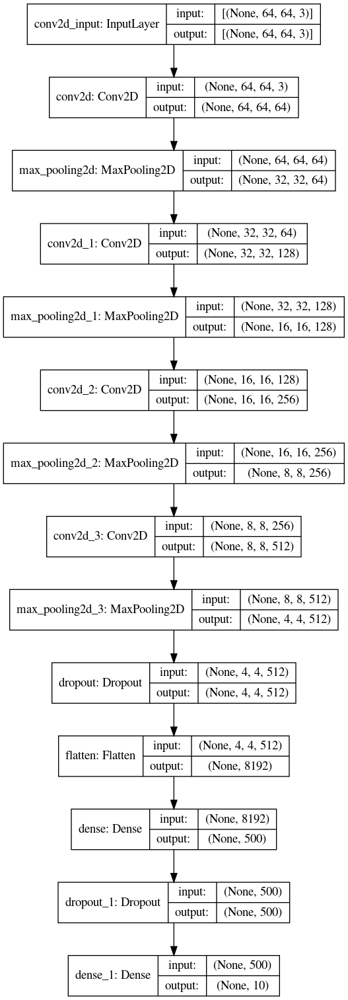

In [28]:
plot_model(model, to_file=os.path.join(model_path,"disracted_driver.png"), show_shapes=True, show_layer_names=True)

# Training

In [29]:
model_history = model.fit(train_data_tensors,y_train,validation_data = (validation_data_tensors, y_validation), epochs=15, batch_size=32, shuffle=True,callbacks=callbacks_list)

Epoch 1/15
421/421 [==============================] - 273s 646ms/step - loss: 1.9519 - accuracy: 0.2550 - val_loss: 0.3731 - val_accuracy: 0.8916

Epoch 00001: val_accuracy improved from -inf to 0.89164, saving model to /kaggle/working/model/self_trained/distractedDriving-01-0.89.hdf5
Epoch 2/15
421/421 [==============================] - 271s 644ms/step - loss: 0.3819 - accuracy: 0.8871 - val_loss: 0.1101 - val_accuracy: 0.9692

Epoch 00002: val_accuracy improved from 0.89164 to 0.96923, saving model to /kaggle/working/model/self_trained/distractedDriving-02-0.97.hdf5
Epoch 3/15
421/421 [==============================] - 269s 640ms/step - loss: 0.1397 - accuracy: 0.9590 - val_loss: 0.0694 - val_accuracy: 0.9773

Epoch 00003: val_accuracy improved from 0.96923 to 0.97726, saving model to /kaggle/working/model/self_trained/distractedDriving-03-0.98.hdf5
Epoch 4/15
421/421 [==============================] - 271s 643ms/step - loss: 0.0774 - accuracy: 0.9769 - val_loss: 0.0512 - val_accurac

Text(0.5, 0, 'Epoch')

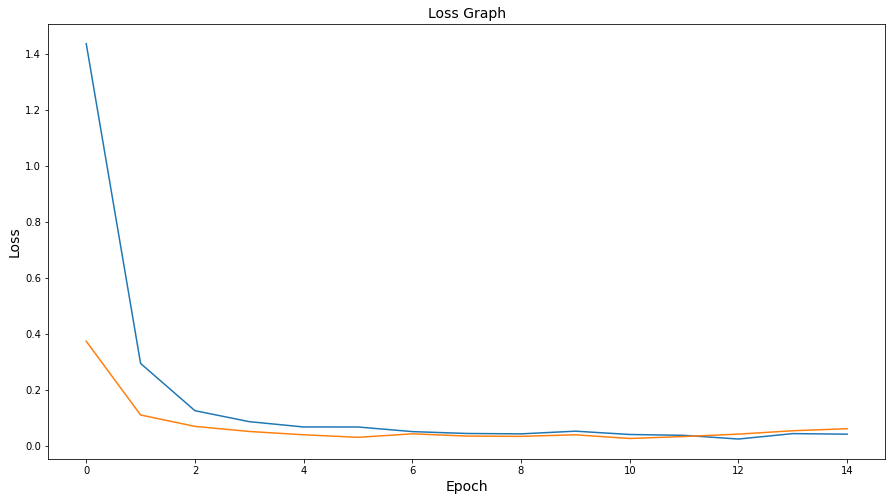

In [44]:
fig = plt.figure(figsize=(15, 8))
plt.plot(model_history.history['loss'],  label="Training loss")
plt.plot(model_history.history['val_loss'],  label="Validation loss")
plt.title('Loss Graph', size=14)
plt.ylabel('Loss', size=14)
plt.xlabel('Epoch', size=14)

Text(0.5, 0, 'Epoch')

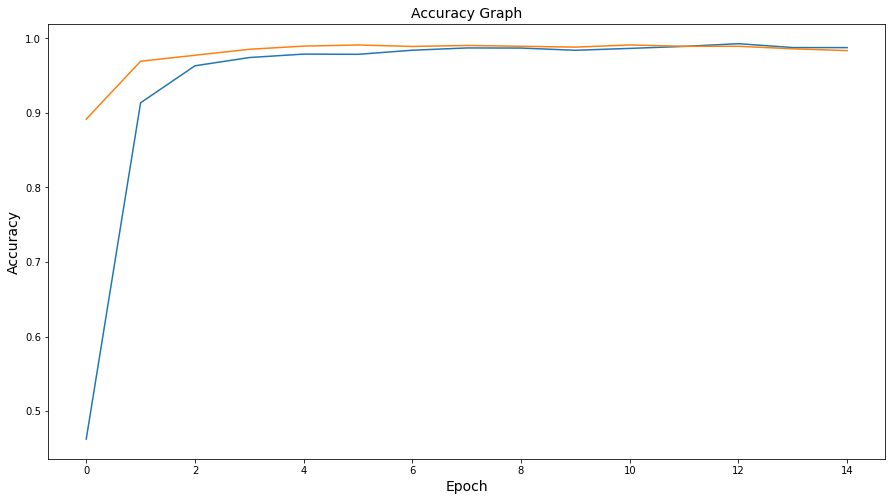

In [45]:
fig = plt.figure(figsize=(15, 8))
plt.plot(model_history.history['accuracy'], label="Training accuracy")
plt.plot(model_history.history['val_accuracy'], label="Validation accuracy")
plt.title('Accuracy Graph', size=14)
plt.ylabel('Accuracy', size=14)
plt.xlabel('Epoch', size=14)

# Evaluation

In [46]:
results = model.evaluate(testing_data_tensors, y_test, batch_size=32)
print("test loss, test acc:", results)

141/141 [==============================] - 21s 151ms/step - loss: 0.0599 - accuracy: 0.9857
test loss, test acc: [0.05987556278705597, 0.9857302308082581]


# Prediction

In [48]:
data_test2 = test_data[:100]

test_tensors = convert_to_tensor(data_test2.iloc[:,0]).astype(np.float32)/255
showtest = data_test2.iloc[:,0]

100%|██████████| 100/100 [00:00<00:00, 181.16it/s]


In [ ]:
classes = {
    0: 'safe driving',
    1: 'texting - right',
    2: 'talking on the phone - right',
    3: 'texting - left',
    4: 'talking on the phone - left',
    5: 'operating the radio',
    6: 'drinking',
    7: 'reaching behind',
    8: 'hair and makeup',
    9: 'talking to passenger',
}

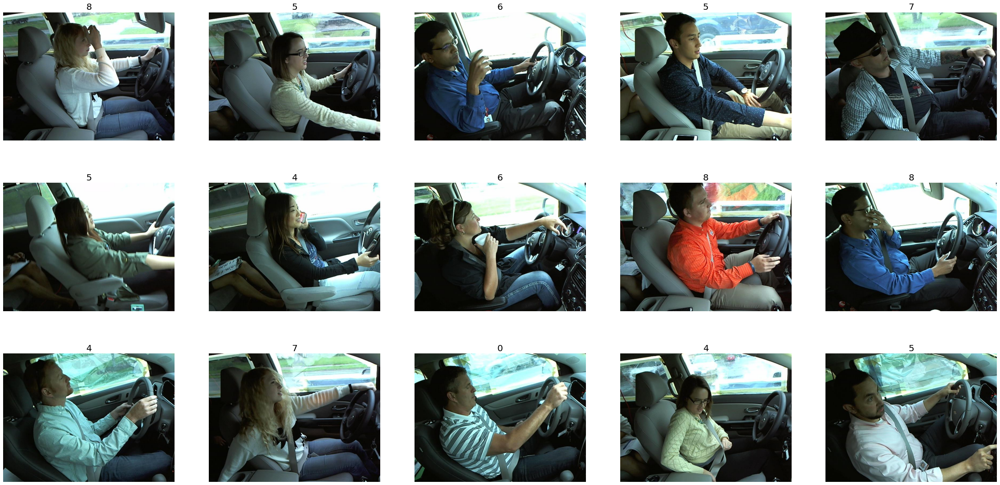

In [60]:
preds = model.predict(test_tensors)
f, ax = plt.subplots(figsize=(40, 20))

for x in range(15):
    plt.subplot(3, 5, x+1)
    predicted = np.argmax(preds[x])
    img = plt.imread(showtest[x])
    plt.imshow(img)
    
    plt.title(predicted, size=20)
    plt.axis('off')